# Implementation of Arbitrary Real-Time Style Transfer using Adaptive Instance Normalization by Xun Huang, Serge Belongie.

-Rami Matar


Before we get started, make sure you have download your content images to content/ and your style images to style/. My recommendation is to use the WikiArt dataset for style images, and MS COCO dataset for content images.

Let's first start with some necessary imports to run this notebook.

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
import torchvision
import torchvision.transforms as transforms
import torchvision.models as models
import torchvision.utils as vutils


import matplotlib.pyplot as plt
import copy
import tqdm.notebook as tq
from PIL import Image, ImageFile
import os
from collections import OrderedDict

Now, let's first set up the data loading for our model. The dataset will need to output a pair of images, namely a content image and a style image. 

We define a function to recursively get all the image files in the content and style directories.

In [ ]:
def get_all_image_files(path):
    '''Get all the image files in the path recursively, useful for labelled datasets'''
    jpg_files = []
    for root, dirs, files in os.walk(path):
        for file in files:
            if file.endswith('.jpg') or file.endswith('.jpeg'):
                jpg_files.append(os.path.join(root, file))
    return jpg_files

We will be utilizing a pretrained VGG model in order to obtain our perceptual features, so let's define the transforms to ensure our input tensors produce the expected behavior with the model.

In [ ]:
ImageFile.LOAD_TRUNCATED_IMAGES = True # Had some images exceed the size limit, this prevent the training loop from crashing when that happens.

imsize = 512 if torch.cuda.is_available() else 128

normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

loader = transforms.Compose([transforms.Resize([imsize, imsize]),
                            transforms.ToTensor(),
                            normalize])

The dataset class will use the PIL library to open the content image and a random style image pair and ensure they are in RGB format, then, it will apply the transform to the images and return the pair.

In [ ]:
class ContentStyleDataset(torch.utils.data.Dataset):
    '''Dataset class for the content and style images, getitem returns a random style image as a pair to the given content image.
    '''
    def __init__(self, content_dir, style_dir, transform=loader):
        self.content_dir = content_dir
        self.style_dir = style_dir
        self.transform = transform
        self.content_filenames = get_all_image_files(content_dir)
        self.style_filenames = get_all_image_files(style_dir)

    def __len__(self):
        return len(self.content_filenames)
        
    def __getitem__(self, idx):
        content_image = Image.open(self.content_filenames[idx])

        if content_image.mode != 'RGB':
            content_image = content_image.convert('RGB')
        random_style_idx = torch.randint(low = 0, high = len(self.style_filenames), size=(1,))
        style_image = Image.open(self.style_filenames[random_style_idx])

        if style_image.mode != 'RGB':
            style_image = style_image.convert('RGB')

        if self.transform:
            content = self.transform(content_image)
            style = self.transform(style_image)
        return content, style

In order to be able to obtain batches of data from the dataset, we need to define a custome collate function in order to take the list of image pairs and turn them into a tensor 

In [ ]:
def collate(batch):
    '''Collate function takes the batch as a list of content style pairs and turns it into a tuple of two tensors with shape (batch_size, 3, imsize, imsize)'''
    content = []
    style = []
    for i in range(len(batch)):
        content.append(batch[i][0])
        style.append(batch[i][1])
    content = torch.stack(content)
    style = torch.stack(style)
    return torch.stack([content, style])

Since we use a transform that normalizes the data, we have to denormalize it when we want to retreive it from the system. Therefore, we define the following function based on the VGG normalization transformations. I overlooked this initially and it caused a lot of confusion.

In [ ]:
def denorm(tensor, device):
    '''Denormalize the tensor to be in the range [0, 1] to invert the transforms for vgg model,
    this is necessary before the output tensor can be converted to the desired output image'''
    std = torch.Tensor([0.229, 0.224, 0.225]).reshape(-1, 1, 1).to(device)
    mean = torch.Tensor([0.485, 0.456, 0.406]).reshape(-1, 1, 1).to(device)
    res = torch.clamp(tensor * std + mean, 0, 1)
    return res

# Model Definition

Encoder: our encoder will be a pretrained VGG19, a classification CNN that we use to treat the perceptual features of our image and enable the style transfer. Importantly, we utilize only the first 4 convolution layers in the VGG network, and discard the rest of the model. We are interested in the output of 4 specific relu layers (The choice will determine the features the model will be able to match) based on some prior implementations.

In [ ]:
class Encoder(nn.Module):
    '''This is the pretrained VGG encoder which we will use to calculate our perceptual features, which are used both for the AdaIN layer
    and the loss function. The encoder is the first 4 layers of the VGG network, with the rest omitted. The forward method returns a list of the intermediate
    outputs of the encoder, which represent the perceptual features of the input image. The output layers are chosen as the relu layers of the VGG network, based on the
    implementation in the AdaIN paper.
    Generally speaking, using different layers from the VGG to calculate the loss will lead to different types of style matching. The earlier layers will capture
    the low level features, while the later layers will capture the high level features.'''
    
    def __init__(self, device = "cpu"): #device as input is useful later.
        super().__init__()
        # you can support multiple models like VGG, Imagenet, or others.
        vgg = models.vgg19(pretrained=True).eval()
        vgg = vgg.features
        vgg = vgg.to(device)
        self.layers = [vgg[0:2], vgg[2:7], vgg[7:12], vgg[12:21]]

        # Turn these off to prevent wasted memory on gradient graphs.
        for param in self.parameters():
            param.requires_grad = False
            
    def forward(self, X):
        # We want to return all the intermediate layers that we specify so they can be used for perceptual features.
        results = []
        for i in range(len(self.layers)):
            X = self.layers[i](X)
            results.append(X)
        return results

Next, we define the Adaptive Instance Normalization layer. This layer is not learnable and simply renormalizes the content features based on the statistics of the style features. This was the key to allowing truly arbitrary style transfer. A prior paper by Ulyanov et. al. found that even the first order statistics of the perceptual features carry the majority of the style information.

In [ ]:
def AdaIN(content_features, style_features):
    batch_size, channels = content_features.shape[0:2]
    # first we compute the mean and standard deviation for each instance and channel for both the content and style features.
    content_std, content_mean = torch.std_mean(content_features, dim = (2,3))
    style_std, style_mean = torch.std_mean(style_features, dim = (2,3))

    # we reshape them to be broadcastable with the content features
    content_mean = content_mean.reshape(batch_size, channels, 1, 1)
    content_std = content_std.reshape(batch_size, channels, 1, 1)
    style_mean = style_mean.reshape(batch_size, channels, 1, 1)
    style_std = style_std.reshape(batch_size, channels, 1, 1)

    # we normalize the content features and then adapt them to the style features. small error term used for numerical stability.
    normalized_content_features = (content_features - content_mean) / (content_std + 1e-9)
    adapted_content_features = (normalized_content_features + (style_mean / (style_std + 1e-9))) * style_std
    
    return adapted_content_features

After passing through the encoder and AdaIN layers, we predict the stylized image using the decoder we are training. Let's define this decoder; many architectures can be chosen here, but this implementation follows the original implementation by the authors which inverts the encoder and uses Upsample and ReflectionPad2d layers instead of pooling layers.

In [ ]:
class Decoder(nn.Module):
    '''The decoder is similar structurally to the VGG encoder but uses upsampling and reflection padding to upsample the image to the desired output size. 
    Otherwise, it is a simple convolutionalal network with relus. The decoder is the part of the network we want to train, and it will take inputs from the encoder
    after passing through the AdaIN layer, and output the stylized image. 
    '''
    def __init__(self, device):
        super().__init__()
        self.decoder = nn.Sequential(
          nn.ReflectionPad2d((1, 1, 1, 1)),
          nn.Conv2d(512, 256, (3, 3)),
          nn.ReLU(),
          nn.Upsample(scale_factor=2, mode='nearest'),
          nn.ReflectionPad2d((1, 1, 1, 1)),
          nn.Conv2d(256, 256, (3, 3)),
          nn.ReLU(),
          nn.ReflectionPad2d((1, 1, 1, 1)),
          nn.Conv2d(256, 256, (3, 3)),
          nn.ReLU(),
          nn.ReflectionPad2d((1, 1, 1, 1)),
          nn.Conv2d(256, 256, (3, 3)),
          nn.ReLU(),
          nn.ReflectionPad2d((1, 1, 1, 1)),
          nn.Conv2d(256, 128, (3, 3)),
          nn.ReLU(),
          nn.Upsample(scale_factor=2, mode='nearest'),
          nn.ReflectionPad2d((1, 1, 1, 1)),
          nn.Conv2d(128, 128, (3, 3)),
          nn.ReLU(),
          nn.ReflectionPad2d((1, 1, 1, 1)),
          nn.Conv2d(128, 64, (3, 3)),
          nn.ReLU(),
          nn.Upsample(scale_factor=2, mode='nearest'),
          nn.ReflectionPad2d((1, 1, 1, 1)),
          nn.Conv2d(64, 64, (3, 3)),
          nn.ReLU(),
          nn.ReflectionPad2d((1, 1, 1, 1)),
          nn.Conv2d(64, 3, (3, 3)),
        ).to(device)

    def forward(self, x):
        return self.decoder(x)

With these components defined, we can define our model now:

In [ ]:
class Model(nn.Module):
    '''The model is a combination of the encoder, decoder, and the AdaIN layer. The forward method takes in the content and style images and returns the stylized image.
    First, both of the content image and style image are passed through the pretrained encoder to obtain the four output layers. Then, those get fed into the AdaIN layer
    which normalizes the content image to the statistics of the style image. Ulyanov, et al. found that Instance Norm is particularly effective for style transfer and that much
    of the style information is contained in the statistics of the perceptual features, and simply matching those can produce style transfer.
    The output of the AdaIN layer is then passed through the decoder network to produce the stylized image.
    The loss is computed by taking the mean squared error of the perceptual features of the content image after the AdaIN layer and the stylized output image. 
    The paper suggests it might be useful to also include second order statistics in the loss computation using correlation alignment, though I did not test that.'''

    def __init__(self, device, training = True, style_weight = 1):
        super().__init__()
        self.training = training
        self.encoder = Encoder(device)
        self.decoder = Decoder(device)
        self.loss = nn.MSELoss()
        self.style_weight = style_weight

    def forward(self, input, alpha = 1.0, content_features = None):
        content = input[0]
        style = input[1]
        content_loss = 0
        style_loss = 0
        # First, we pass both the content and style through the fixed encoder, we take the last result in the content features and all intermediate steps for the style features
        if content_features == None:
            content_features = self.encoder(content)[-1]
        style_features = self.encoder(style)
        # After we have the features, we compute the Adaptive Instance Normalization module and do a forward pass in the decoder
        decoder_input = AdaIN(content_features, style_features[-1])
        decoder_input = alpha * decoder_input + (1 - alpha) * content_features
        decoded = self.decoder(decoder_input)
        stylized = decoded
        # After the forward pass, we have a predicted output image, we can stop here if we are using the model for inference
        # but if we are training, then we feed the decoder's output through the fixed encoder to receive our perceptual features for the loss function, so we calculate the content and style loss
        if self.training:
            predicted_features = self.encoder(decoded)
            # The content loss is simply MSE between the encoded features of the original content image after the AdaIN layer and the stylized prediction features, calculated only using the last relu.
            content_loss = self.loss(predicted_features[-1], decoder_input)
            # The style loss is also MSE but between the first order statistics of each of the four intermediate layers.
            for i in range(len(self.encoder.layers)):
                predicted_std_statistics, predicted_mean_statistics = torch.std_mean(predicted_features[i], dim = (2,3))
                target_std_statistics, target_mean_statistics = torch.std_mean(style_features[i], dim = (2,3))
                style_loss += self.loss(predicted_mean_statistics, target_mean_statistics) + self.loss(predicted_std_statistics, target_std_statistics)

        return content_loss, style_loss, stylized



# Now, we can start defining our training procedure

Our trainer needs a few inputs:
1. Our model which defined above.
2. A dataloader from the ContentStyleDataset
3. hyperparameters: 
- Learning rate: based on the paper, 1e-4 using the adam optimizer.
- Learning rate decay: also based on the implementation by the authors
- Loss function parameter: to scale between the content loss and style loss. Changing this value will train the model to adopt the style more or less intensely. The paper used a value of 10 but I trained using a value of 2.5. Importantly, there will still remain flexibility with intensity of the style effect in the inference process that does not need to be explicitly learned.

Our trainer will also need to define some essential and very useful things for us:
- training loop
- model saving and loading
- loop to overfit on one batch (useful sanity check)
- tensorboard logs

We will utilize the notebook version of the tqdm library to visualize the training progress.

In [ ]:
class Trainer():
    def __init__(self, model, dataloader, learning_rate, save_every, save_model_every, writer, lr_decay = 5e-5, k = 2.5):
        self.device = "cuda:0" if torch.cuda.is_available() else "cpu"
        self.model = model
        self.dataloader = dataloader
        self.lr = learning_rate
        self.save_every = save_every # how often to save an output image during the training process. Useful to visualize how the model learns. 0 means never save.
        self.save_model_every = save_model_every
        self.writer = writer
        self.optimizer = torch.optim.Adam(self.model.decoder.parameters(), lr = self.lr)
        self.lr_decay = lr_decay # ratio of learning rate decay, default value is from the paper implementation.
        self.k = k # scaling the loss function
        self.epoch = 0
        self.step = 0
        
    def learning_rate_decay(self):
        lr = self.lr / (1.0 + self.lr_decay * self.step)
        for param_group in self.optimizer.param_groups:
            param_group['lr'] = lr

    def logs(self, step, content, style, stylized, content_loss, style_loss, loss):
       # if step == 0:
            #self.writer.add_graph(self.model, (torch.randn(self.dataloader.batch_size, 3, 128, 128), torch.randn(self.dataloader.batch_size, 3, 128, 128)))
        self.writer.add_scalar("Style Loss", style_loss, step)
        self.writer.add_scalar("Content Loss", content_loss, step)
        self.writer.add_scalar("Total Loss", loss, step)
        if self.save_every != 0 and step % self.save_every == 0:
            grid = vutils.make_grid([denorm(content[0].squeeze(), self.device), denorm(style[0].squeeze(), self.device), denorm(stylized[0].squeeze(), self.device)], nrow = 3) 
            self.writer.add_image("Style Transfer Result", grid, step)
            vutils.save_image(grid, 'outputs/step'+str(self.step)+'.png')

    def save_model(self, epoch, step):
        checkpoint = {
            "model" : self.model.state_dict(),
            "epoch" : epoch + 1,
            "optimizer": self.optimizer.state_dict(),
            "step": self.step
        }
        PATH = "checkpoint.pt"
        torch.save(checkpoint, PATH)

    def load_checkpoint(self):
        PATH = "checkpoint.pt"
        checkpoint = torch.load(PATH, map_location = self.device)
        self.model.load_state_dict(checkpoint['model'])
        self.optimizer.load_state_dict(checkpoint['optimizer'])
        self.epoch = checkpoint['epoch']
        self.step = checkpoint['step']
        print("RESUMING FROM EPOCH ", self.epoch)


    def train(self, num_epochs):
        with tq.trange(self.epoch, num_epochs, desc="All epochs") as epochs:
            for epoch in epochs:
                self.run_epoch(epoch)

    def run_epoch(self, epoch_num):
        num_batches = len(self.dataloader)
        progress_bar = tq.trange(num_batches, desc = "epoch" + str(epoch_num) + " gpu: " + str(self.device))
        for batch_num, data in enumerate(self.dataloader):
            self.learning_rate_decay()
            data = data.to(self.device)
            content_loss, style_loss, loss = self.training_step(epoch_num, batch_num, data)
            progress_bar.update(1)
            progress_bar.set_postfix(content_loss = content_loss.item(), style_loss = style_loss.item(), total_loss = loss.item())
            if batch_num % 100 == 0:
                self.save_model(epoch_num, batch_num)

    def training_step(self, epoch, batch_num, data):
        content, style = data
        content_loss, style_loss, stylized = self.model(data)
        loss = content_loss + self.k * style_loss
        
        self.step += 1
        self.logs(self.step, content, style, stylized, content_loss, style_loss, loss)
        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()
        return content_loss, style_loss, loss
    

One more function to load all the objects needed for the trainer

In [ ]:
def load_train_objects(device, writer_dir):
    model = Model(device)
    dataset = ContentStyleDataset('content', 'style', transform = loader)
    dataloader = DataLoader(dataset, batch_size = 4, collate_fn = collate, shuffle = True, num_workers = 2)
    writer = SummaryWriter(writer_dir)
    return model, dataloader, writer

Now let's load up tensorboard and prepare to start training!

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

And let the training begin!
P.S. make sure to connect to GPU if you can, otherwise it will be very slow! I'm using just a few images to run this, but the usage should be with the training datasets.

In [ ]:
def run(total_epochs, load, writer_dir, overfit):
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    model, dataloader, writer = load_train_objects(device, writer_dir)
    trainer = Trainer(model, dataloader, learning_rate = 1e-4, save_every = 10, save_model_every = 100, writer = writer)
    if load:
        trainer.load_checkpoint()
    if overfit:
        trainer.overfit(10000)
    else:
        trainer.train(total_epochs)

run(total_epochs = 2, load = False, writer_dir = None, overfit = False)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

All epochs:   0%|          | 0/2 [00:00<?, ?it/s]

epoch0 gpu: cuda:0:   0%|          | 0/37 [00:00<?, ?it/s]

epoch1 gpu: cuda:0:   0%|          | 0/37 [00:00<?, ?it/s]

The model should start producing good results after seeing 20000~ images. After training, your checkpoint.pt file should contain the model, which we will use now to generate some cool art!

Let's define a class that can help us with evaluation. The goal is to have our input data in two folders, a content and a style folder, and be able to generate all style combinations from the model inference and to save them.

First thing we will need is a different dataset since we don't want the same random pairing behavior.

In [ ]:
class ImageFolderDataset(torch.utils.data.Dataset):
    '''Dataset for one folder representing either content or style images. Very standard, converts image to RGB, applies transforms, and returns the image tensor'''
    def __init__(self, path, transform=loader):
        self.path = path
        self.transform = transform
        self.filenames = get_all_image_files(path)
    
    def __len__(self):
        return len(self.filenames)
    
    def __getitem__(self, idx):
        image = Image.open(self.filenames[idx])
        if image.mode != 'RGB':
            image = image.convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image
    

We define a class that can load our model and dataloaders and evaluate the style transfers using the model we trained.

In [ ]:
class Eval():
    def __init__(self, model, content_directory, style_directory, output_dir, save_all_style_grids = False, alpha = 1.0):
        self.device = "cuda" if torch.cuda.is_available() else "cpu"
        self.model = model.to(self.device).eval()
        self.model.training = False
        content_dataset = ImageFolderDataset(content_directory, loader)
        style_dataset = ImageFolderDataset(style_directory, loader)
        self.output_dir = output_dir
        self.content_dataloader = DataLoader(content_dataset, batch_size = 1, shuffle = False, num_workers = 0)
        self.style_dataloader = DataLoader(style_dataset, batch_size = 1, shuffle = False, num_workers = 0)
        self.alpha = alpha
        self.step = 0
        self.save_all_style_grids = save_all_style_grids
    
    def evaluate(self):
        # set model to evaluation mode
        self.model.eval()
        num = len(self.content_dataloader)
        # loop over the content images, and for each create the necessary style transfers.
        progress_bar = tq.trange(0, num, desc = "Evaluating model on images")
        for idx, content in enumerate(self.content_dataloader):
            content = content.to(self.device)
            self.evaluate_and_save_styled(content, idx)
            progress_bar.update(self.content_dataloader.batch_size)

    def evaluate_and_save_styled(self, content, idx):
        # save the content image for the grid display
        content_out = denorm(content.squeeze(), self.device)
        styles = [content_out]
        # get the content features from the pretrained VGG encoder and reuse them in all the forward passes
        content_features = self.model.encoder(content)[-1] 
        for style in self.style_dataloader:
            style = style.to(self.device)
            # forward pass with the precalculated content features.
            _, _, stylized = self.model((content, style), content_features = content_features)
            # denormalize to turn into valid images
            style_out = denorm(style.squeeze(), self.device)
            stylized_out = denorm(stylized.squeeze(), self.device)
            # create the grid of the content, style, and stylized images and save it.
            grid = vutils.make_grid([content_out, style_out, stylized_out], nrow = 3)
            vutils.save_image(grid, self.output_dir + str(idx).zfill(5) + '_' + str(self.step)+ '.png')
            self.step += 1
            styles.append(stylized_out)
        if self.save_all_style_grids:
            # in save_all_style mode, all the computed styles are used to make one supergrid that has the content image with every possible style.
            grid = vutils.make_grid(styles, nrow = torch.max(torch.tensor(len(styles)), torch.tensor(6)))
            vutils.save_image(grid, self.output_dir + str(idx).zfill(5) + '_allstyles.png')

    def load_ddp_checkpoint(self, PATH, from_DDP = False):
        if torch.cuda.is_available():
            state_dict = torch.load(PATH)['model']
        else:
            state_dict = torch.load(PATH, map_location = torch.device('cpu'))['model']
        # This is essential if we save the model during DDP training and want to do inference on a single GPU or CPU.
        if from_DDP:
            new_state_dict = OrderedDict()
            for k, v in state_dict.items():
                name = k[7:] # remove 'module.' of DataParallel/DistributedDataParallel
                new_state_dict[name] = v
            state_dict = new_state_dict
        self.model.load_state_dict(new_state_dict)


def load_from_arguments(args):
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    model = Model(device, training = False) # skip the loss calculation in inference
    eval = Eval(model, args['content_directory'], args['style_directory'], args['output_directory'], args['save_all_styles_grids'], args['alpha'])
    return eval

args = {
    'content_directory': 'test_content/',
    'style_directory': 'test_style/',
    'output_directory': 'test_output/',
    'model_path': 'checkpoint.pt',
    'save_all_styles_grids': True,
    'alpha' : 1.0
}

eval = load_from_arguments(args)
eval.load_ddp_checkpoint(args['model_path'], from_DDP = True)
eval.evaluate()




Evaluating model on images:   0%|          | 0/3 [00:00<?, ?it/s]

Great! We're pretty much done, let's look at some outputs!

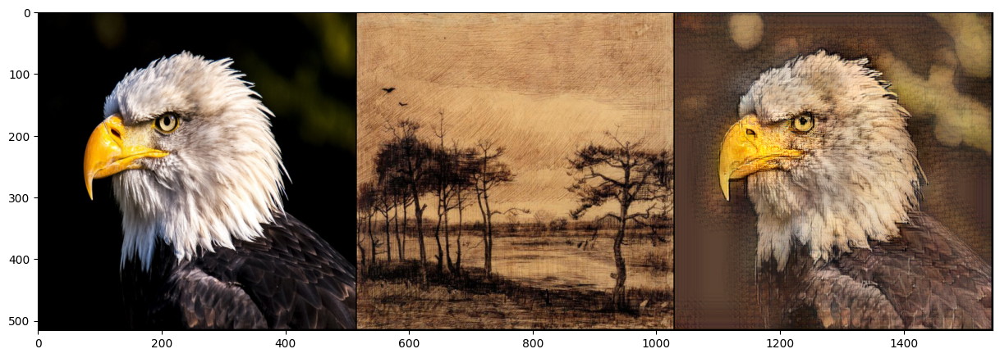

In [ ]:
img = Image.open('test_output/00001_10.png')
fig = plt.figure(figsize=(15,7.5), dpi=100)  
plt.imshow(img)
plt.show()

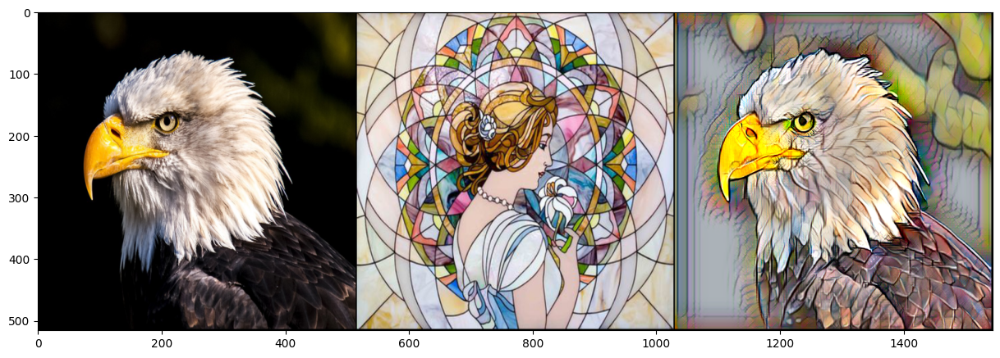

In [ ]:
img = Image.open('test_output/00001_11.png')
fig = plt.figure(figsize=(15,7.5), dpi=100)  
plt.imshow(img)
plt.show()

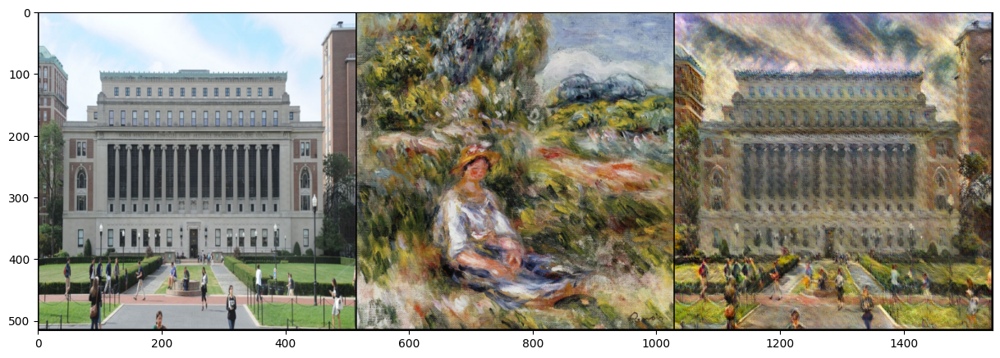

In [ ]:
img = Image.open('test_output/00002_15.png')
fig = plt.figure(figsize=(15,7.5), dpi=100)  
plt.imshow(img)
plt.show()

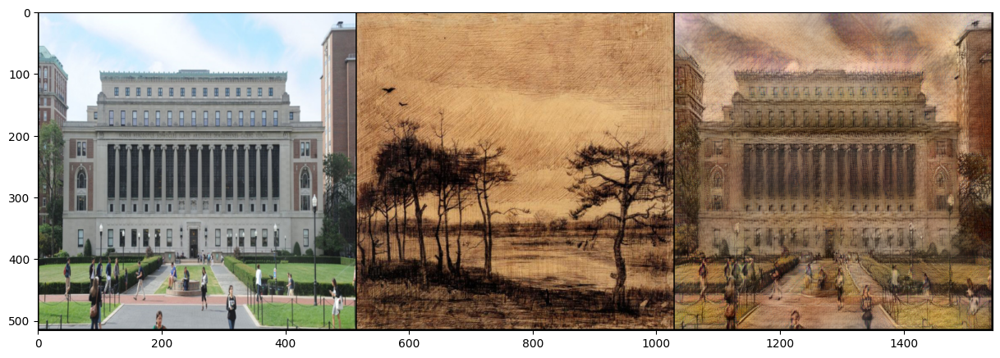

In [ ]:
img = Image.open('test_output/00002_16.png')
fig = plt.figure(figsize=(15,7.5), dpi=100)  
plt.imshow(img)
plt.show()

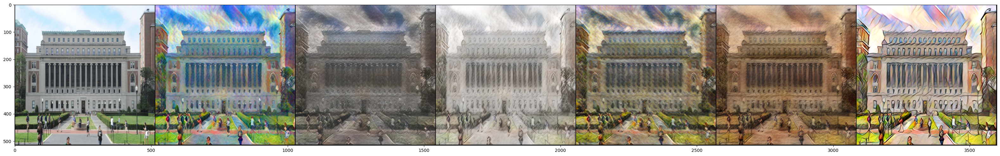

In [ ]:
img = Image.open('test_output/00002_allstyles.png')
fig = plt.figure(figsize=(40,7.5), dpi=100)  
plt.imshow(img)
plt.show()